# COM3502-4502-6502 Speech Processing - Python Programming Assignment

## 1. General Information

This programming assignment is worth 55% of the overall course mark.

You are free to complete this assignment in your own time. However, feedback, advice and guidance is available during the lab classes and via the discussion board on Blackboard. 

Note: Via these channels we try to help you as much as possible, but will not debug your code or provide solutions to the assignment itself.

Note: It will take some time to complete this assignment, so plan your work accordingly over the coming weeks. Read these instructions carefully.

Note: Please be aware that students registered on COM4502 and COM6502 have **additional tasks** to perform. These are marked ‘COM4502-6502 Only’.

Note: You should always ensure that your results (e.g. in terms of plots you create) are clear to undrestand and leave no room for mis-interpretation. This can often easily achieved by adding proper $x$- and $y$-axis labels, titles, legends etc. Where results are not clear to interprete, this might result in missed points. 


## 1.1 Student Data

Student Family Name: <span style="font-weight:bold;color:orange">**Han**</span> 

Student Given Name(s): <span style="font-weight:bold;color:orange">**Yetong**</span>

Date of submission: <span style="font-weight:bold;color:orange">**17th December 2021**</span>

Academic Year 2021/2022

## 1.2 Copyright

This programming assignment is part of the lecture COM[3502](http://www.dcs.shef.ac.uk/intranet/teaching/public/modules/level3/com3502.html "Open web page for COM3502 module")-[4502](http://www.dcs.shef.ac.uk/intranet/teaching/public/modules/level4/com4502.html "Open web page for COM4502 module")-[6502](http://www.dcs.shef.ac.uk/intranet/teaching/public/modules/msc/com6502.html "Open web page for COM4502 module") Speech Processing at the [University of Sheffield](https://www.sheffield.ac.uk/ "Open web page of The University of Sheffield"), Dept. of [Computer Science](https://www.sheffield.ac.uk/dcs "Open web page of Department of Computer Science"), University of Sheffield.

This notebook is licensed as an assignment to be used during the lecture COM3502-4502-6502 Speech Processing at the University of Sheffield. Any further use is only permitted if agreed with the [module lead](mailto:s.goetze@sheffield.ac.uk).

It should be a matter of course that rules of [unfair means](https://www.sheffield.ac.uk/apse/apo/quality/assessment/unfair) apply and the assignment is not to be shared with or made available to other persons besides those participating in the module during the same academic year. This includes publishing on web pages etc. All questions can be asked during the lab classes or using the Blackboard Discussion board.


## 1.3 Hand-In Procedure and Deadline

Once you have completed the assignment you should submit a `.zip` file (via Blackboard) containing your solution (as a file named `YourName.ipynb`) and possibly other source linked in your Jupyter Notebook. Also the `.zip` filename should be of the form `YourName.zip`. Please make also sure that your name is entered correctly in the section above.

Standard departmental penalties apply for [late hand-in](https://sites.google.com/sheffield.ac.uk/comughandbook/general-information/assessment/late-submission) and [plagiarism](https://sites.google.com/sheffield.ac.uk/comughandbook/general-information/assessment/unfair-means).

The **deadline** for handing-in this assignment (via Blackboard) is 
<span style="font-weight:bold;color:red">**Friday 17th December 2022**</span>

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task 0:**
    
Ensure that you data is correctly entered in the section at the top of this sheet and that the filename is in the form `YourName.ipynb`. 
    
</div>

## 1.4 Libraries

You should be familar to the use of the following Python libraries from the lab. You should not need to use additional ones. You are allowed to use additional libraries if necessary for your code. If they need to be installed by `!pip install <libraryname>` or `!conda install <libraryname>`, please indicate this as a comment in your code. You should not make use of libraries that can't be installed by either `!pip install` or `!conda install`. You have to ensure that your Notebook runs "out of the box". You can test this on the Computer Lab machines in the Diamond if you are unsure and using your own computer.

In [1]:
#Let's do some necessary and nice-to-have imports
%matplotlib inline
import matplotlib.pyplot as plt    # plotting
#import seaborn as sns; sns.set()  # styling
import numpy as np                 # math

import soundfile as sf             # to load files
from IPython import display as ipd # for sound playback

from scipy import signal           # filter designs (if not already imported)

## 2. Download, load, and analyse audio

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T1:**
    
* Load a wave file containing speech. You can find a file at <a href="https://staffwww.dcs.shef.ac.uk/people/S.Goetze/sound/speech.wav"> https://staffwww.dcs.shef.ac.uk/people/S.Goetze/sound/speech.wav</a> and should be able to download this. You can also use your own WAVE files if you prefer this. If you want to record WAVE files and are using your own computer, the program [Audacity](https://www.audacityteam.org/download/) is one possibility to [record WAVE files](https://manual.audacityteam.org/man/basic_recording_editing_and_exporting.html).
    
* Visualise the signal in time domain, in the spectral domain (as spectrum) and as a time-frequency representation (spectrogram). Please ensure proper axis labels for all your plot in this assignment.

* Playback the signal.
    
</div>

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
 29 1812k   29  528k    0     0  1173k      0  0:00:01 --:--:--  0:00:01 1173k
100 1812k  100 1812k    0     0  1976k      0 --:--:-- --:--:-- --:--:-- 1974k


[-0.00241089 -0.00259399 -0.00241089 ...  0.00866699  0.00866699
  0.0085144 ]


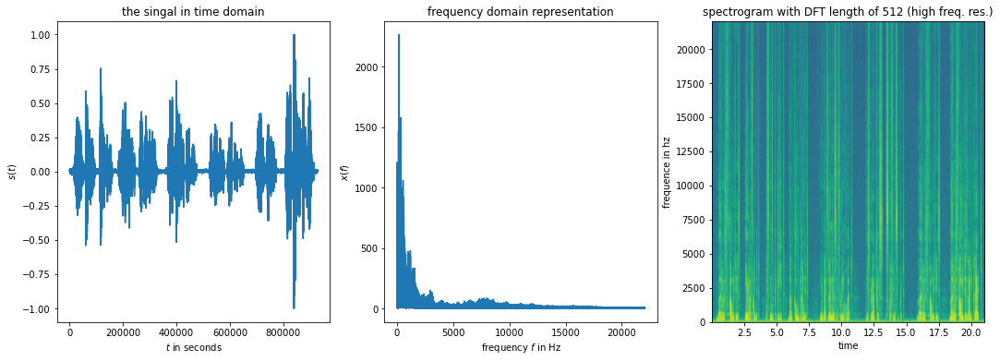

<Figure size 432x288 with 0 Axes>

In [2]:
# your code here
#
# download the file
s_file_name = 'speech.wav'
!curl https://staffwww.dcs.shef.ac.uk/people/S.Goetze/sound/speech.wav -o speech.wav 

s, fs = sf.read('speech.wav')
print(s)


# do some plot
fig = plt.figure(figsize=(18,6))

# plot the time domain signal
plt.subplot(1,3,1)
plt.plot(s)
plt.title('the singal in time domain')
plt.xlabel('$t$ in seconds')
plt.ylabel('$s(t)$')

# plot the signal in the spectral domain
plt.subplot(1,3,2)
FFT_length = len(s) # take a power of two which is larger than the signal length
f = np.linspace(0, fs/2, num=int(FFT_length/2+1))
spectrum = np.abs(np.fft.rfft(s,n=FFT_length))
plt.plot(f,spectrum)
plt.title('frequency domain representation')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')

# plot the singal in time-frequency representation (spectrogram).
plt.subplot(1,3,3)
LDFT=512
plt.specgram(s, Fs=fs,noverlap=256, NFFT=LDFT)
plt.title('spectrogram with DFT length of ' + str(LDFT) + ' (high freq. res.)')
plt.ylabel('frequence in hz')
plt.xlabel('time')

plt.show()
plt.tight_layout()

# listen to the sound file
ipd.Audio(s,rate=fs)

<br>
<div style="border: 2px solid #999; padding: 10px; background: #9696ff;">
    
**Question Q1:**

* Determine the sampling frequency $f_s$ in Hz and the length of the signal in seconds. What is the sampling interval $T_s$ of your signal? What is the highest occuring frequency?
    
Note: You can either give your answer in form of a code block (e.g. by using the `print()` functions) or as text. For the latter, change the [type of the next cell](https://jupyter-notebook.readthedocs.io/en/stable/notebook.html#structure-of-a-notebook-document) from `code` to `markdown` or use the yellow example text below.
    
</div>

In [3]:
# Your answer here 
print('the sample frequency in Hz is:' + str(fs) + "Hz")
print('the length of the signal in seconds is:' + str(len(s)*(1/fs)) + 's')
print('The sampling interval Ts is: '+ str(1/fs)+ 's')
print('The highest occuring frequency is: ' + str(max(s)) + 'Hz' )
# ...

the sample frequency in Hz is:44100Hz
the length of the signal in seconds is:21.04503401360544s
The sampling interval Ts is: 2.2675736961451248e-05s
The highest occuring frequency is: 0.999969482421875Hz


<span style="font-weight:bold;color:orange">In case you want to answer by written text, we would appreciate if you  colour-code your answers, e.g. like using orange font colour as illustrated in this example. This helps us, not to overlook parts of your answers.</span>

## 3. Piece-wise linear filtering in the time domain

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T2:**
    
* Design a high-pass filter with a cut-off frequency of $\approx 500$ Hz using a filter design method of your choice. 
* Design a low-pass filter with a cut-off frequency of $\approx 500$ Hz.
* Design a band-stop filter with a cut-off frequencies of $\approx 300$ Hz and of $\approx 1.1$ kHz.
* Simulate the effect of a land-line telephone by eliminating all energy below 300 Hz and above 3,400 Hz.
* Visualise the transfer functions of the filters and the zero-pole plots.
* Apply the designed filters, compare filter input and output as a time-frequency visualisation and play back the filtered signal.
    
Note: Don't forget proper labeling / description of your figures to make clear what is what.
</div>

In [4]:
## Visualise the transfer functions of the filters and the zero-pole plots.
def zplane(z, p, title='Poles and Zeros'):
    ax = plt.gca()
    ax.plot(np.real(z), np.imag(z), 'bo', fillstyle='none', ms=10)
    ax.plot(np.real(p), np.imag(p), 'rx', fillstyle='none', ms=10)
    unit_circle = plt.Circle((0, 0), radius=1, fill=False,
                             color='black', ls='--', alpha=0.9)
    ax.add_patch(unit_circle)

    plt.title(title)
    plt.xlabel('Re{$z$}')
    plt.ylabel('Im{$z$}')
    plt.axis('equal')

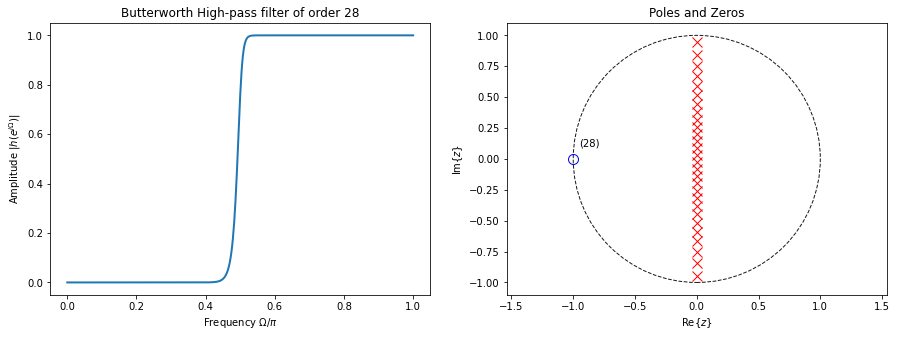

In [5]:
## design a high-pass filter with a cut-off frequency of  ≈500  Hz 
wp=0.490;    # passband edge frequency 
ws=0.525;     # stopband edge frequency 
Rp_lin=0.9; # allowed ripples in the pass band area
Rs_lin=0.1; # allowed ripples in the stop band area

Rp=-20*np.log10(Rp_lin);  # max passband ripple in dB
Rs=-20*np.log10(Rs_lin);  # min stopband attenuation in dB

# get lowest filter order N to fullfill requirements above
N, Wn = signal.buttord(wp, ws, Rp, Rs) ###Butterworth filter order selection.

# design High-pass filter of order N using butterworth method
b, a = signal.butter(N, Wn, 'High') 

h=np.abs(np.fft.fft(b,1024))/np.abs(np.fft.fft(a,1024));
h=h[0:513] # only show first half (positive frequencies)
omega=np.linspace(0,1,513)

# plot frequency response
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(omega, abs(h), lw=2)
plt.title('Butterworth High-pass filter of order ' + str(N))
plt.ylabel('Amplitude $|h(e^{j \Omega})|$');
plt.xlabel('Frequency $\Omega/\pi$');

# plot zeros and poles in the z plane
plt.subplot(1, 2, 2)
zplane(-1, np.roots(a))
plt.text(-0.95,0.1,'('+str(N)+')'); # adding text with info how many zeros are located a z=-1

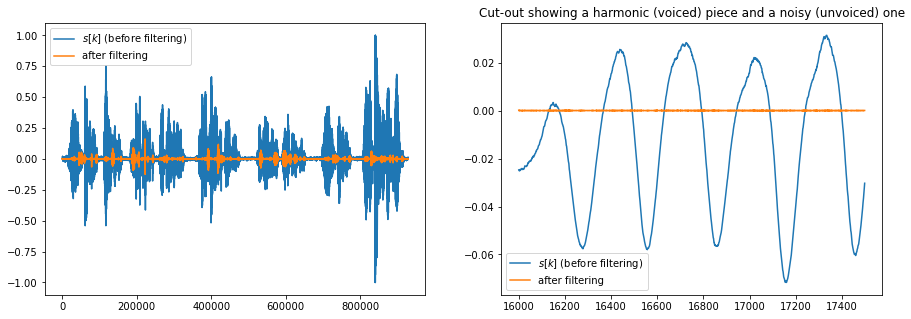

In [6]:
s_filtered = signal.filtfilt(b, a, s)

# plot frequency response
plt.figure(figsize=(15,5))
plt.subplot(1,2,1) # plot signal before and after filtering in time domain
plt.plot(s,label='$s[k]$ (before filtering)')
plt.plot(s_filtered,label='after filtering')
plt.legend()

plt.subplot(1,2,2) # zoom into the signal 
start_idx=16000
end_idx=start_idx+1500
plt.plot(np.arange(start_idx,end_idx),s[start_idx:end_idx],label='$s[k]$ (before filtering)')
plt.plot(np.arange(start_idx,end_idx),s_filtered[start_idx:end_idx],label='after filtering')
plt.title('Cut-out showing a harmonic (voiced) piece and a noisy (unvoiced) one')
plt.legend();

In [7]:
ipd.Audio(s_filtered, rate=fs)

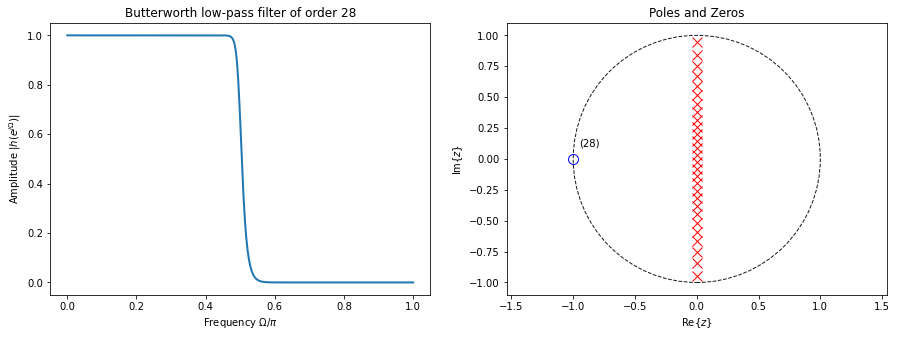

In [8]:
## design a low-pass filter with a cut-off frequency of  ≈500  Hz
wp=0.490;    # passband edge frequency 
ws=0.525;     # stopband edge frequency 
Rp_lin=0.9; # allowed ripples in the pass band area
Rs_lin=0.1; # allowed ripples in the stop band area

Rp=-20*np.log10(Rp_lin);  # max passband ripple in dB
Rs=-20*np.log10(Rs_lin);  # min stopband attenuation in dB

# get lowest filter order N to fullfill requirements above
N, Wn = signal.buttord(wp, ws, Rp, Rs) #Butterworth filter order selection.
# design Low-pass filter of order N using butterworth method
b, a = signal.butter(N, Wn, 'low')  

h=np.abs(np.fft.fft(b,1024))/np.abs(np.fft.fft(a,1024));
h=h[0:513] # only show first half (positive frequencies)
omega=np.linspace(0,1,513)

# plot frequency response
# plot_tolerance_scheme(wp,ws,Rp_lin,Rs_lin)
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(omega, abs(h), lw=2)
plt.title('Butterworth low-pass filter of order ' + str(N))
plt.ylabel('Amplitude $|h(e^{j \Omega})|$');
plt.xlabel('Frequency $\Omega/\pi$');

# plot zeros and poles in the z plane
plt.subplot(1, 2, 2)
zplane(-1, np.roots(a))
plt.text(-0.95,0.1,'('+str(N)+')'); # adding text with info how many zeros are located a z=-1

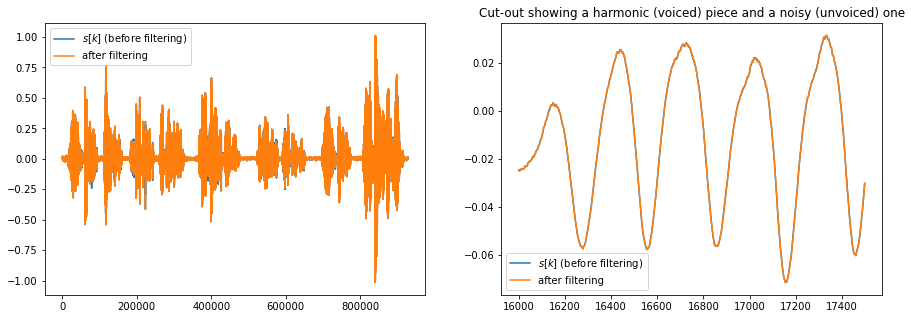

In [9]:
s_filtered = signal.filtfilt(b, a, s)

# plot frequency response
plt.figure(figsize=(15,5))
plt.subplot(1,2,1) # plot signal before and after filtering in time domain
plt.plot(s,label='$s[k]$ (before filtering)')
plt.plot(s_filtered,label='after filtering')
plt.legend()

plt.subplot(1,2,2) # zoom into the signal 
start_idx=16000
end_idx=start_idx+1500
plt.plot(np.arange(start_idx,end_idx),s[start_idx:end_idx],label='$s[k]$ (before filtering)')
plt.plot(np.arange(start_idx,end_idx),s_filtered[start_idx:end_idx],label='after filtering')
plt.title('Cut-out showing a harmonic (voiced) piece and a noisy (unvoiced) one')
plt.legend();

In [10]:
ipd.Audio(s_filtered, rate=fs)

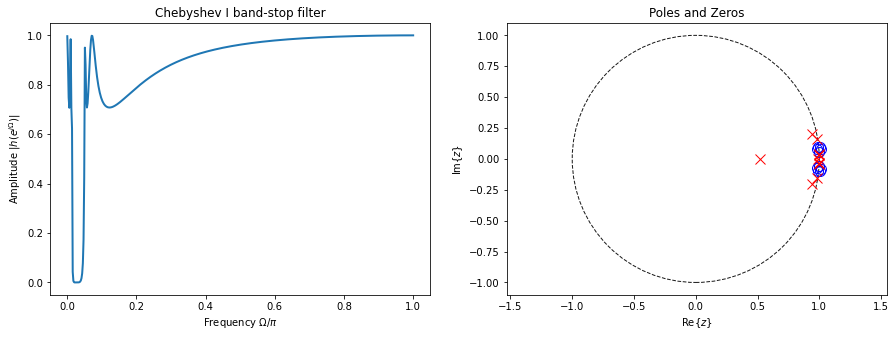

In [11]:
## design a band-stop filter with a cut-off frequency of  ≈300  Hz or of ≈1100  Hz
lowcut = 300*2/fs 
highcut = 1100*2/fs
# design Band-Stop filter using cheby1 method
b, a = signal.cheby1(5, 3, [lowcut, highcut], btype = 'bandstop')
f,h=signal.freqz(b,a)
omega=np.linspace(0,1,len(f))

# plot frequency response
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(omega, abs(h), lw=2)
plt.title('Chebyshev I band-stop filter')
plt.ylabel('Amplitude $|h(e^{j \Omega})|$');
plt.xlabel('Frequency $\Omega/\pi$');

# plot zeros and poles in the z plane
plt.subplot(1, 2, 2)
zplane(np.roots(b), np.roots(a))
# plt.text(-0.95,0.1,'('+str(N)+')'); # adding text with info how many zeros are located a z=-1

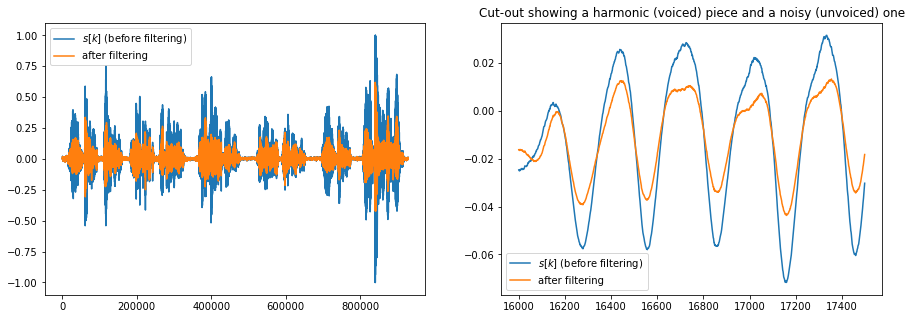

In [12]:
s_filtered = signal.filtfilt(b, a, s)

# plot frequency response
plt.figure(figsize=(15,5))
plt.subplot(1,2,1) # plot signal before and after filtering in time domain
plt.plot(s,label='$s[k]$ (before filtering)')
plt.plot(s_filtered,label='after filtering')
plt.legend()

plt.subplot(1,2,2) # zoom into the signal 
start_idx=16000
end_idx=start_idx+1500
plt.plot(np.arange(start_idx,end_idx),s[start_idx:end_idx],label='$s[k]$ (before filtering)')
plt.plot(np.arange(start_idx,end_idx),s_filtered[start_idx:end_idx],label='after filtering')
plt.title('Cut-out showing a harmonic (voiced) piece and a noisy (unvoiced) one')
plt.legend();

In [13]:
ipd.Audio(s_filtered, rate=fs)

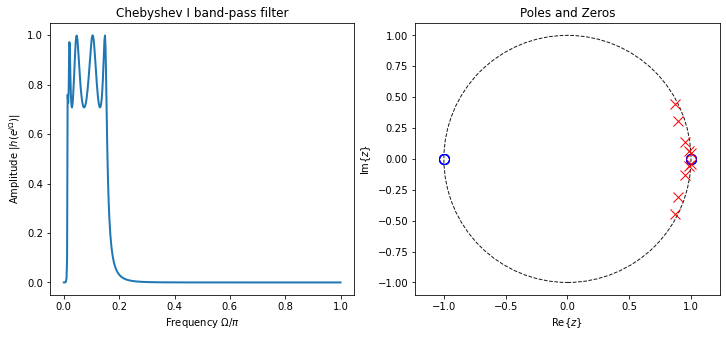

In [14]:
## eliminating all energy below 300 Hz and above 3,400 Hz.
lowcut = 300*2/fs 
highcut = 3400*2/fs
## Use chebyshev I filter
b, a = signal.cheby1(5, 3, [lowcut, highcut], btype = 'bandpass')
f,h=signal.freqz(b,a)
omega=np.linspace(0,1,len(f))

# plot frequency response
# plot_tolerance_scheme(wp,ws,Rp_lin,Rs_lin)
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(omega, abs(h), lw=2)
plt.title('Chebyshev I band-pass filter')
plt.ylabel('Amplitude $|h(e^{j \Omega})|$');
plt.xlabel('Frequency $\Omega/\pi$');

# plot zeros and poles in the z plane
plt.subplot(1, 2, 2)
zplane(np.roots(b), np.roots(a))
# plt.text(-0.95,0.1,'('+str(N)+')'); # adding text with info how many zeros are located a z=-1

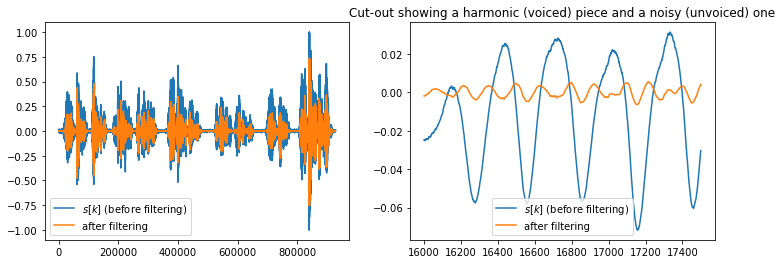

In [15]:
s_filtered = signal.filtfilt(b, a, s)

# plot frequency response
plt.figure(figsize=(12,4))
plt.subplot(1,2,1) # plot signal before and after filtering in time domain
plt.plot(s,label='$s[k]$ (before filtering)')
plt.plot(s_filtered,label='after filtering')
plt.legend()

plt.subplot(1,2,2) # zoom into the signal 
start_idx=16000
end_idx=start_idx+1500
plt.plot(np.arange(start_idx,end_idx),s[start_idx:end_idx],label='$s[k]$ (before filtering)')
plt.plot(np.arange(start_idx,end_idx),s_filtered[start_idx:end_idx],label='after filtering')
plt.title('Cut-out showing a harmonic (voiced) piece and a noisy (unvoiced) one')
plt.legend();

In [16]:
ipd.Audio(s_filtered, rate=fs)

<br>
<div style="border: 2px solid #999; padding: 10px; background: #9696ff;">
    
**Question Q2:**

* Explain the behaviour of the designed band-stop filter, i.e. describe (briefly) what you can see in the generated plots. If you didn't generate plots you can explain what you would expect to see.

    
</div>

**Answer to Question Q2:**


<span style="font-weight:bold;color:orange">
From the graph of band-stop filter, we can see that when the frequencies between 300hz and 1100hz, the signal drop down to the zero, below 300hz and over 1100hz the signal can normally pass.
</span> 

<br>
<div style="border: 2px solid #999; padding: 10px; background: #9696ff;">
    
**Question Q3:**

* Which sounds are most affected when the low-pass cut-off frequency is set to around $500$
Hz - vowels or consonants - and why?
    
</div>

**Answer to Question Q3:**

<span style="font-weight:bold;color:orange">
The consonants will be affected more than vowels, because the consonants (k, p, s, t, etc.) are predominantly found in the frequency range above 500 Hz, and the low-pass filter cut-off the frequency which above 500HZ
</span>

## 4. Audio Effects

### 4.1 Low Frequency Oscillator

Many ‘Voice effects (FX)’ are achieved by modifying some characteristic of the speech using a low frequency oscillator or *LFO*. LFOs typically have two controls: speed (which is specified by the frequency in Hertz) and depth (which specifies the magnitude of the effect). The following tasks will require several LFOs, so it makes sense to implement one in the following.

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T3:**
    
* Implement a Low Frequency Oscillator as a function `lfo()` as described below. Visualise that your function works be generating a sine and a square wave of frequency $5$ Hz and length $2$ seconds with different depths.
    
Note: There will be an extra point in the marking if you **do not** use the `scipy` library to solve this task.
    
</div>

In [17]:
def lfo(speed_hz, depth, num_samples, fs=44100, square_curve=False):
    '''
    Low-frequency oscillator
    
    Parameters
    ----------
    speed_hz : float
       frequency of generated signal in Hertz
    depth : float
        magnitude of the effect
    num_samples : int
        length of the signal in samples
    fs : float, optional 
        sampling frequency in Hz, default 44100
    square_curve : boolean, optional (default: False)
        generate square wave if true, generate sine wave if false

    Example use:
    -------
        sig_square = lfo(speed_hz=5, depth=0.7, num_samples=88250, fs=44100, square_curve=True)
    '''
    
    # Your code here 
    
    if square_curve == True:
        wave = square_wave(l = num_samples, f0 = speed_hz, fs = fs, dp = depth, order=10)
    else:
        wave = get_sine_wave(f0 = speed_hz, l = num_samples, fs = fs, dp=depth)
        
    return wave
        
def square_wave(l, f0, fs, dp, order=10):
    t=np.arange(0,l,1/fs)  # time vector
    sum = np.zeros(len(t)) # pre-allocate variable with zeros 
    for ii in range(1, order+1, 2):
        sum += np.sin(2*np.pi*ii*f0*t)/ii
    return (4/np.pi*sum) * dp, t

def get_sine_wave(f0, l, fs, dp):
    t = np.arange(0,l,1/fs)
    sin_wave = np.sin(2*np.pi*f0*t)
    return sin_wave * dp, t
        
    

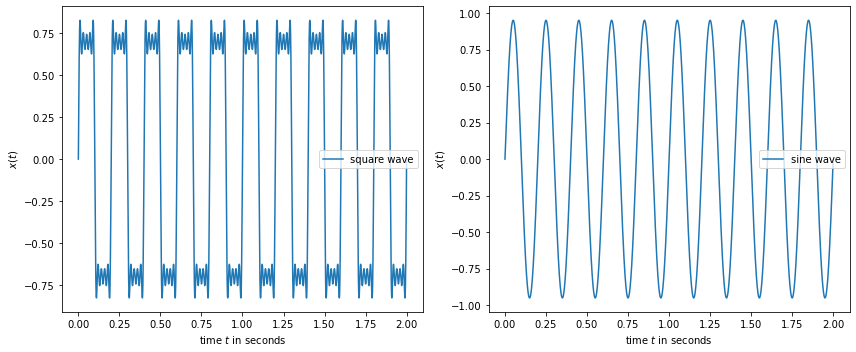

In [18]:
# Your code here to show that the LFO works
sig_square, t1= lfo(speed_hz=5, depth=0.7, num_samples=2, fs=44100, square_curve=True)
sig_sine, t2 = lfo(speed_hz=5, depth=0.95, num_samples=2, fs=44100, square_curve=False)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(t1, sig_square, label='square wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
# plt.xlim(0,2)
plt.legend()


plt.subplot(1, 2, 2)
plt.plot(t2, sig_sine, label='sine wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
# plt.xlim(0,2)
plt.legend()
plt.tight_layout() # this allowes for some space for the title text.

Although your function outputs audio, you are unlikely to be able to hear it as the frequency is so low. However, you can check that it is functioning correctly by combining is with other audio signals as we will do in the following.

### 4.2 Amplitude Modulation - Tremolo

*Tremolo* is one of the most basic voice manipulations that makes use of an LFO. In this effect, the amplitude of a speech signal is [modulated](https://en.wikipedia.org/wiki/Amplitude_modulation), i.e. the speech waveform is multiplied by a variable gain that ranges between 0 and 1. 

Your LFO outputs an audio signal between `-depth` and `+depth`. So, in order to modulate the amplitude of the speech correctly, the output of the LFO has to be scaled appropriately to range between $0$ and $1$.

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T4:**
    
* Implement  a function `tremolo()` using your function `lfo()` and modulate the amplitude of the speech signal. Experiment with different settings for `speed` and `depth`. In particular, note that a square wave with speed between 3 and 4 Hz (and depth = 1) has a very destructive effect on the intelligibility of the output. This is because 3-4 Hz corresponds to the typical syllabic rate of speech.
    
</div>

In [19]:
def tremolo(signal, fs, speed_hz, depth, number_sample, square_curve=False):
    '''
    Applies a tremolo effect to a signal
    
    Parameters
    ----------
    signal : float
       input signal to which the effect should be applied
    fs : int
        sampling frequency in Hz
    speed_hz : float
       frequency of LFO and by this also the effect
    depth : float
        magnitude of the effect
    square_curve : boolean, optional
        generate square wave if true, generate sine wave if false
    
    Return
    ----------
    signal after application of tremolo effect
    
    Example use:
    -------
        signal_tremolo = tremolo(audio_in, fs, 10, 1, square_curve=False)
    '''
    
    # Your code here
    n=number_sample
    x1=s[0:n*fs];
    
    if square_curve == True:
        getsigl, t = lfo(speed_hz=speed_hz, depth=depth, num_samples=n, fs=fs, square_curve=True)
    else:
        getsigl, t = lfo(speed_hz=speed_hz, depth=depth, num_samples=n, fs=fs, square_curve=False)
        
    # Map Lfo signal to range (0,1)
    signal = getsigl*depth*x1
    a = 0
    b = 1
    signal = ((b-a)/(np.max(signal)-np.min(signal)))* (signal-np.min(signal))
        
    return signal, t
        
        
    
    
    

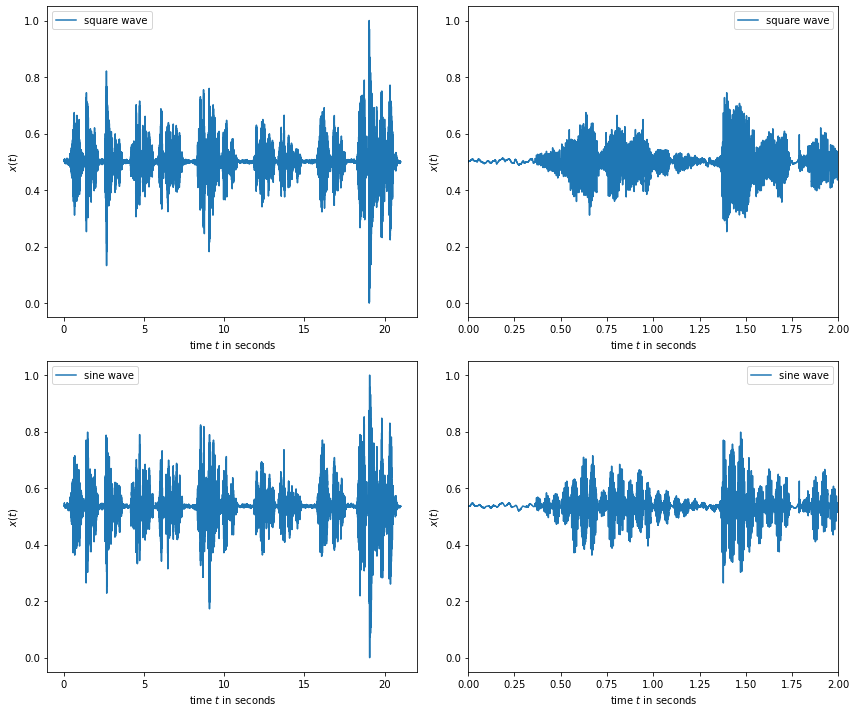

In [20]:
# Your code here to show an example of the Tremolo effect
signal_tremolo1, t1 = tremolo(signal=s, fs=fs, speed_hz=10, depth=1, square_curve=True, number_sample=int(len(s)/fs))
signal_tremolo2, t2 = tremolo(signal=s, fs=fs, speed_hz=10, depth=1, square_curve=False, number_sample=int(len(s)/fs))

plt.figure(figsize=(12, 10))
plt.subplot(2, 2, 1)
plt.plot(t1, signal_tremolo1, label='square wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
plt.legend()

# zoom into the signal 
plt.subplot(2, 2, 2)
plt.plot(t1, signal_tremolo1, label='square wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
plt.legend()
plt.xlim(0,2)


plt.subplot(2, 2, 3)
plt.plot(t2, signal_tremolo2, label='sine wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
plt.legend()

# zoom into the signal 
plt.subplot(2, 2, 4)
plt.plot(t2, signal_tremolo2, label='sine wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
plt.xlim(0,2)
plt.legend()
plt.tight_layout() 

In [21]:
ipd.Audio(signal_tremolo1, rate=fs)

In [22]:
ipd.Audio(signal_tremolo2, rate=fs)

### 4.3 Ring Modulation

Another basic effect is to multiply the speech signal by the output of an LFO. This is known as ‘ring modulation’.

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T5:**
    
* Implement  a function `ring_modulation()` using your function `lfo()` and modulate the amplitude of the speech signal by multiplying with the LFO signal. Experiment with different settings for `speed` and `depth`. Note how the
timbre of the resulting sound is subtly different from *tremolo*.
    
</div>

Note: In the BBC TV series [Dr. Who](https://en.wikipedia.org/wiki/Doctor_Who), the voices of the alien [Daleks](https://en.wikipedia.org/wiki/Dalek) are generated by a ring modulator with an LFO set to around 30 Hz. The voice actors also spoke using a stilted monotonic intonation in order to enhance the effect. You can try this yourself by
recording your own voice and applying the effect.

In [23]:
def ring_modulation(signal, fs, speed_hz, depth, number_sample, square_curve=False):
    '''
    Applies a ring modulation effect to a signal
    
    Parameters
    ----------
    signal : float
       input signal to which the effect should be applied
    fs : int
        sampling frequency in Hz
    speed_hz : float
       frequency of LFO and by this also the effect
    depth : float
        magnitude of the effect
    square_curve : boolean, optional
        generate square wave if true, generate sine wave if false
    
    Return
    ----------
    signal after application of the ring modulation effect
    
    Example use:
    -------
        signal_ring_mod = ring_modulation(audio_in, fs, 10, 1, square_curve=False)
    '''
    n=number_sample
    x1=s[0:n*fs];
    
    if square_curve == True:
        getsigl, t = lfo(speed_hz=speed_hz, depth=depth, num_samples=n, fs=fs, square_curve=True)
    else:
        getsigl, t = lfo(speed_hz=speed_hz, depth=depth, num_samples=n, fs=fs, square_curve=False)
        
    return getsigl*depth*x1, t

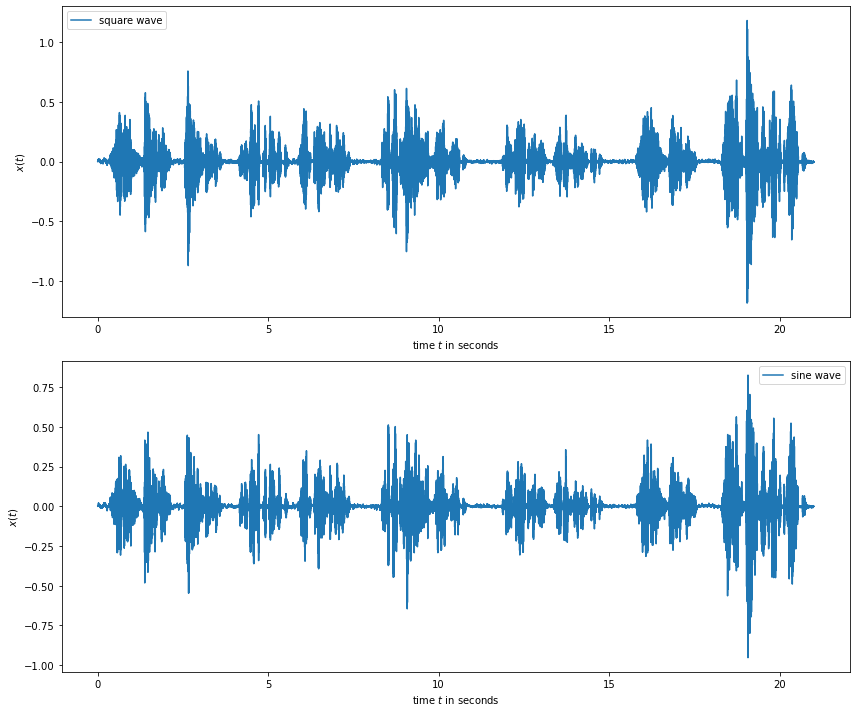

In [24]:
# Your code here to show an example of the Ring Modulation effect
signal_rm1, t1 = ring_modulation(signal=s, fs=fs, speed_hz=10, depth=1, square_curve=True, number_sample=int(len(s)/fs))
signal_rm2, t2 = ring_modulation(signal=s, fs=fs, speed_hz=10, depth=1, square_curve=False, number_sample=int(len(s)/fs))

plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(t1, signal_rm1, label='square wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
# plt.xlim(0,2)
plt.legend()


plt.subplot(2, 1, 2)
plt.plot(t2, signal_rm2, label='sine wave');
plt.xlabel('time $t$ in seconds'); plt.ylabel('$x(t)$')
# plt.xlim(0,2)
plt.legend()
plt.tight_layout() # this allowes for some space for the title text.

In [25]:
ipd.Audio(signal_rm1, rate=fs)

In [26]:
ipd.Audio(signal_rm2, rate=fs)

### 4.4 Frequency Shifting

Many Vocal FX are the result of altering the frequencies present, e.g. changing the pitch of a voice. There are many algorithms for frequency shifting. You have already implemented an approximate solution with your ring modulator.

For simplicity, the following function will be givem implementing frequency shifting.

In [27]:
# the following code in this cell is taken and slightly adapted from:
# https://gist.github.com/lebedov/4428122

import scipy.signal

def nextpow2(n):
    '''Return the first integer N such that 2**N >= abs(n)'''
    return int(np.ceil(np.log2(np.abs(n))))

def frequency_shift(signal, fs, shift_amount):
    '''
    Shift the specified signal by the specified frequency.
    
    Parameters
    ----------
    signal : float
       input signal to which the effect should be applied
    fs : int
        sampling frequency in Hz
    shift_amount : float
       amount of frequency shift (in Hz)
   
    Return
    ----------
    signal after application of the frequancy shifting effect
    
    Example use:
    -------
        signal_frequency_shifted = frequency_shift(audio_in, fs, 100)
    '''

    # Pad the signal with zeros to prevent the FFT invoked by the transform from
    # slowing down the computation:
    N_orig = len(signal)
    N_padded = 2 ** nextpow2(N_orig)
    t = np.arange(0, N_padded)
    return (
        scipy.signal.hilbert(
            np.hstack((signal, np.zeros(N_padded - N_orig, signal.dtype)))
        )
        * np.exp(2j * np.pi * shift_amount * t / fs)
    )[:N_orig].real

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T6:**
    
* Visualise the effect of the frequency shift effect using an appropriate spectral representation.
    
</div>

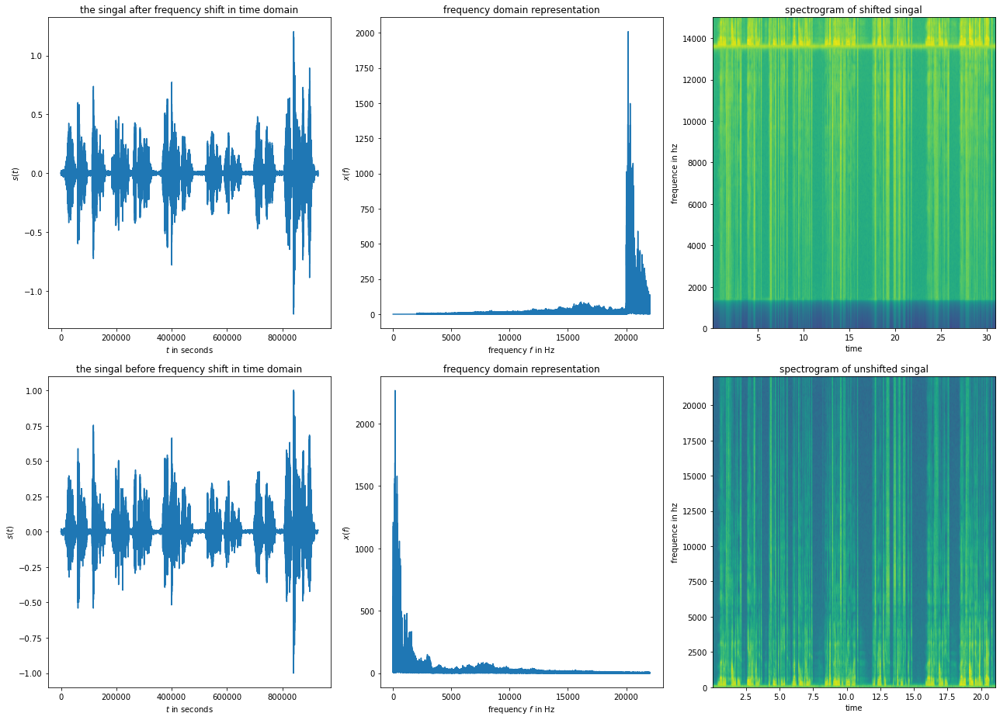

In [28]:
# Your code here to show an example of the frequency shift effect
#
signalfs = frequency_shift(s, fs, 20000)

plt.figure(figsize=(18, 13))
plt.subplot(2, 3, 1)
plt.plot(signalfs)
plt.title('the singal after frequency shift in time domain')
plt.xlabel('$t$ in seconds')
plt.ylabel('$s(t)$')

plt.subplot(2, 3, 2)
# calculate the spectum (frequency domain representation)
FFT_length = len(signalfs) 
f1 = np.linspace(0, fs/2, num=int(FFT_length/2+1))
spectrum1 = np.abs(np.fft.rfft(signalfs,n=FFT_length))
plt.plot(f1,spectrum1)
plt.title('frequency domain representation')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')


plt.subplot(2, 3, 3)
LDFT=512
plt.specgram(signalfs, Fs=30000,noverlap=256, NFFT=LDFT)
plt.title('spectrogram of shifted singal')
plt.ylabel('frequence in hz')
plt.xlabel('time')



plt.subplot(2, 3, 4)
plt.plot(s)
plt.title('the singal before frequency shift in time domain')
plt.xlabel('$t$ in seconds')
plt.ylabel('$s(t)$')

plt.subplot(2, 3, 5)
# calculate the spectum (frequency domain representation)
FFT_length = len(s) # take a power of two which is larger than the signal length
f2 = np.linspace(0, fs/2, num=int(FFT_length/2+1))
spectrum2 = np.abs(np.fft.rfft(s,n=FFT_length))
plt.plot(f2,spectrum2)
plt.title('frequency domain representation')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')


plt.subplot(2, 3, 6)
LDFT=512
plt.specgram(s, Fs=fs,noverlap=256, NFFT=LDFT)
plt.title('spectrogram of unshifted singal')
plt.ylabel('frequence in hz')
plt.xlabel('time')
plt.tight_layout()


<br>
<div style="border: 2px solid #999; padding: 10px; background: #9696ff;">
    
**Question Q4:**

* COM3502-4502-6502: Why can the voice be shifted up in frequency much further than
it can be shifted down in frequency before it becomes severely distorted? Hint: Calculate a spectrum plot if the answer is not immediately clear to you.
* COM4502-6502 ONLY: Your frequency shifter changes all the frequencies present in an input signal. How might it be possible to change the pitch of a voice without altering the formant frequencies?
    
</div>

**Answer to Question Q4:**

<span style="font-weight:bold;color:orange">
    1) The frequency shift will alter the signal of the partials and make the sound inharmonic, unless the shift amount is equal to the frequency of one of the harmonic partials in the original sound. Shifting down may result in negative frequencies.<br>    
    2) If we change the pitch of a voice without altering the formant frequencies, the output audio timbre will not change with frequency.
</span>

### 4.5 Harmony Effect

A classic ‘robotic’ voice can be achieved by simply adding frequency-shifted speech back to the unprocessed original. This effect is known as ‘harmony’. However, rather than simply adding the signals in equal amounts, we will implement a more general purpose approach.

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T7:**
    
* Implement a function `mixer()` that adds the original speech with the manipulated speech in different proportions. 
* Implement a function `harmony()` mixes the input signal with a frequency shifted version of itself (using the funtions `mixer()` and `frequency_shift()`). With your mixer at the 50-50 setting, experiment with different frequency shifts in order to produce the best robotic sounding output. Report "your optimal" setting. 
</div>

In [29]:
# Your code here to implement mixing of two signals, used later for the harmony effect
## Function of implement mixing of two signals
def mixer(signal_original, signal_manipulated, percentage=0.5):
    '''signal_original: 
           input signal 1 to mixed; 
       signal_manipulated:
           input signal 2 to mixed; 
       percentage : 
           the proportion of maniputed signal          
    '''
    mixsignal = signal_original*percentage + signal_manipulated*(1-percentage)
    
    return mixsignal

In [30]:
# def harmony(...
# Your code here to implement the harmony effect
## Function of implement the harmony effect
def harmony(signalin, fs, fre_shift):
    '''signalin: 
           input signal to which the effect should be applied; 
       fs: 
           the sample frequency in Hz;
       fre_shift: 
           amount of frequency shift in Hz
    '''
    
    
    signal_original = signalin
    signal_manipulated = frequency_shift(signal = signalin, fs=fs, shift_amount=fre_shift)
    signal_mixed = mixer(signal_original, signal_manipulated, percentage=0.5)
    
    return signal_mixed
    

In [31]:
# Your code here to show an example of the harmony effect
signalmix = harmony(s, fs, 23000)
# plt.plot(signalmix)
ipd.Audio(signalmix, rate=23000)

**Answer to question in Task T7:**

<span style="font-weight:bold;color:orange">
    ...your answer here ... <br>
  My optimal setting is 23000hz <br>
    because the speed and intonation are very similar to the robot in my mind, just like transformers.
</span>

### 4.6 Frequency Modulation: Vibrato

Now that you have the ability to shift the frequencies in a speech signal, it is very easy to implement another common voice manipulation technique - *vibrato*. All that is required is for the frequency shifter to be controlled by the output of an LFO.



<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T8:**
    
* Implement a function `vibrato()` by connecting an LFO to your frequency shifter, and experiment with different values for speed and depth . Note that the LFO output will need to be scaled to provide an appropriate frequency shift range and then added to the output of the frequency shift slider.
    
</div>



In [32]:
# def vibrato(...
## define a function to implement vibrato effect
def vibrato(signal, speed_hz, depth, fs, square_curve):
    '''signal: 
           input signal to which the effect should be applied; 
       fs: 
           the sample frequency in Hz;
       delay: 
           the fundmental delay time in seconds
       speed_hz :
           frequency of LFO and by this also the effect
       depth : 
           magnitude of the effect
       square_curve : boolean, optional
           generate square wave if true, generate sine wave if false
    '''
    signlfo, t = lfo(speed_hz, depth, num_samples=(1048576/fs), fs=fs, square_curve=square_curve)
    signlfosc = signlfo*0.3
    signfrsf = frequency_shift(signal, fs, shift_amount=signlfosc)
    return signfrsf

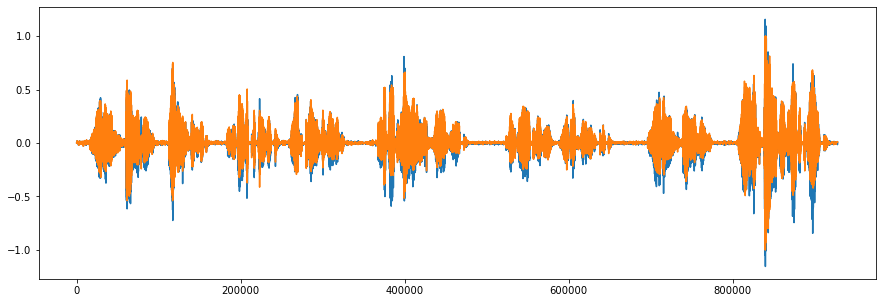

In [33]:
# Your code here to show an example of the vibrato effect
signal_vib = vibrato(signal=s, speed_hz=3, depth=1, fs=fs, square_curve=True)
plt.figure(figsize=(15,5))
plt.plot(signal_vib)
plt.plot(s)

# play the output signal
ipd.Audio(signal_vib, rate=fs)

### 4.7 Time Delay Effect - Echo and Comb Filter

Many interesting voice FX can be achieved by delaying the signal and recombining it with itself. 

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T9:**
    
* Implement a function `echo()` which mixes a signal $s(t)$ with itself in a delayed version, i.e. $s(t-t_0)$. Experiment with various values for the delay $t_0$, and note the different effects you can achieve with delays 
  * below 20 msecs
  * between 20 and 100 msecs, and 
  * above 100 msecs.
</div>

In [34]:
# def echo(...
# Define a function to implement echo effect
def echo(signalin, fs, delay):
    
    '''signalin: 
           input signal to which the effect should be applied; 
       fs: 
           the sample frequency in Hz;
       delay: 
           the fundmental delay time in seconds
    '''
     
    t0 = delay * fs
    si = signalin
    delaysignal = np.zeros(int(t0))
    delaysl = np.hstack((delaysignal, si))
    delaysl2 = np.hstack((si, delaysignal))
    b = mixer(delaysl2, delaysl, 0.5)
    
    return b
    

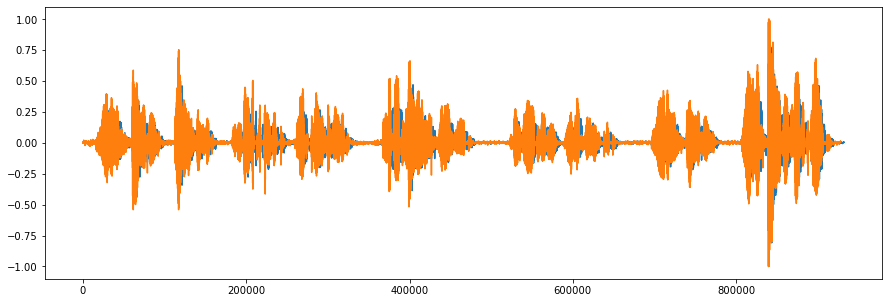

In [35]:
# Your code here to show an example of the echo effect
#
signalecho = echo(s, fs, 0.09 )
plt.figure(figsize=(15,5))
plt.plot(signalecho)
plt.plot(s)
ipd.Audio(signalecho, rate=fs)

### 4.8 Comb Filtering 

You should observe that, with delays below $20$ msec in your function `echo()`, the signals combine to create a subtle ‘phasing’ effect. This is known as ‘comb filtering’ as the signal is effectively interfering with itself, and frequency components corresponding to multiples of the delay time are enhanced or cancelled out (due to ‘superposition’). Delays between $20$ and $100$ msecs give the effect of the voice being in a reverberant room. Delays above $100$ msecs sound like distant echoes.

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T10:**
    
* Visualise the impulse response of your function `echo()` as well as the transfer function. Can you give an explanation from havin a look at the transfer function, why this effect would be called *comb filter*?
</div>

Text(0.5, 0, 'time')

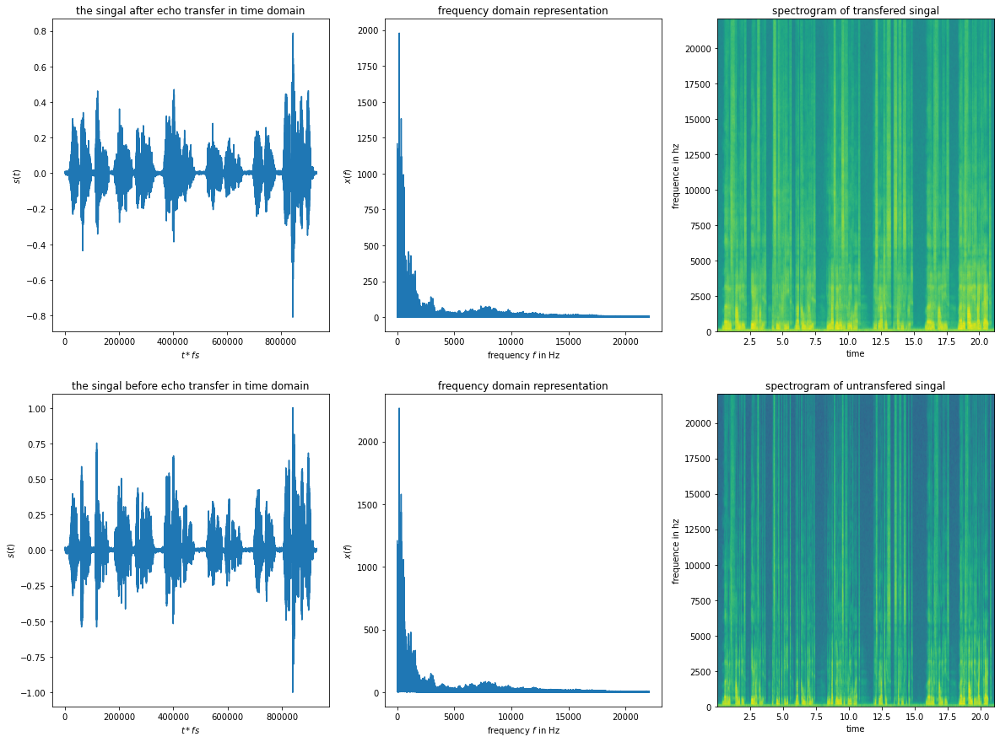

In [36]:
# Your code here 
#
## Visualise the impulse response
signalecho = echo(s, fs, 0.09 )

plt.figure(figsize=(20, 15))

## Visualise the singal after echo transfer in time domain
plt.subplot(2, 3, 1)
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')
plt.plot(signalecho)
# plt.xlim(2*fs, 4*fs)
plt.title('the singal after echo transfer in time domain')
plt.xlabel('$t * fs$')
plt.ylabel('$s(t)$')

## Visualise the singal after echo transfer in time domain
plt.subplot(2, 3, 2)
# calculate the spectum (frequency domain representation)
FFT_length = len(signalecho)
f1 = np.linspace(0, fs/2, num=int(FFT_length/2+1))
spectrum1 = np.abs(np.fft.rfft(signalecho,n=FFT_length))
plt.plot(f1,spectrum1)
plt.title('frequency domain representation')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')

## Visualise the spectrogram of transfered singal
plt.subplot(2, 3, 3)
DFT=512
# plt.specgram(signalecho)
plt.specgram(signalecho, Fs=fs,noverlap=256, NFFT=LDFT)
plt.title('spectrogram of transfered singal')
plt.ylabel('frequence in hz')
plt.xlabel('time')
# plt.xlim(0, 20)


plt.subplot(2, 3, 4)
plt.plot(s)
# plt.xlim(2*fs, 4*fs)
plt.title('the singal before echo transfer in time domain')
plt.xlabel('$t * fs$')
plt.ylabel('$s(t)$')

plt.subplot(2, 3, 5)
FFT_length = len(s) 
f2 = np.linspace(0, fs/2, num=int(FFT_length/2+1))
spectrum2 = np.abs(np.fft.rfft(s,n=FFT_length))
plt.plot(f2,spectrum2)
plt.title('frequency domain representation')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')

plt.subplot(2, 3, 6)
LDFT=512
plt.specgram(s, Fs=fs,noverlap=256, NFFT=LDFT)
plt.title('spectrogram of untransfered singal')
plt.ylabel('frequence in hz')
plt.xlabel('time')
# plt.xlim(0, 40)

Text(0.5, 0, 'frequence in hz')

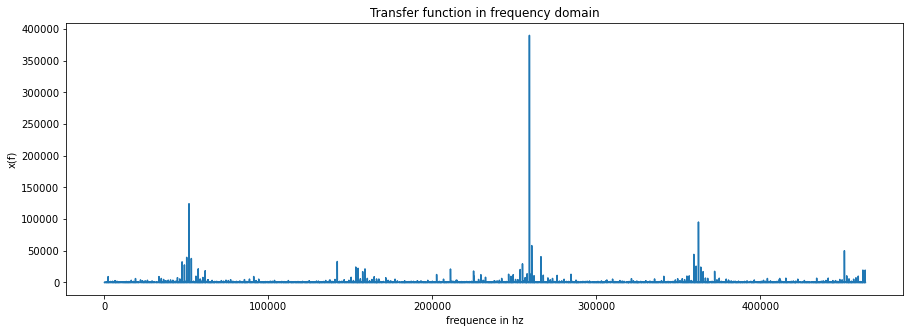

In [37]:
## Then we plot the transfer function
plt.figure(figsize=(15,5))
plt.plot(spectrum2/spectrum1[:len(spectrum2)])
plt.title('Transfer function in frequency domain')
plt.ylabel('x(f)')
plt.xlabel('frequence in hz')

**Answer to question in Task T10:**

<span style="font-weight:bold;color:orange">
    Because the output signal is combined by the audio signal and it's delay signal, it causes the output signal in the same frequency range to appear at intervals,and its characteristic curve is like a comb, so it is called comb filter.
</span>

### 4.9 Flanger 

It is possible to use an LFO to vary the delay. The resulting effect is known as a *flanger*.

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T11:**
    
* Add an LFO to your ‘delay’ to create a ‘flanger’, and experiment with different settings. Note that you will need to scale the output of the LFO, and you will get different effects depending on whether the delayed signal is mixed with the original or not.
</div>

In [38]:
## Define a function to create flanger 
def flanger(signalin, fs, delay, speed_hz, depth, square_curve, mix_original=True):
    '''signalin: 
           input signal to which the effect should be applied; 
       fs: 
           the sample frequency in Hz;
       delay: 
           the fundmental delay time in seconds
       speed_hz :
           frequency of LFO and by this also the effect
       depth : 
           magnitude of the effect
       square_curve : boolean, optional
           generate square wave if true, generate sine wave if false
    '''
   
    si = signalin
    signaldelaylfo1, t1 = lfo(speed_hz=speed_hz, depth=depth, num_samples=len(si)/fs, fs=fs, square_curve=square_curve)
    modwave= delay * fs + signaldelaylfo1/2+0.5
    out = si.copy()
    for i in range(len(si)):
        index = int(i-modwave[i])
        if index>=0 and index<=len(s):
            if mix_original == True:
                out[i] = si[i]+si[index]
            else:
                out[i] = si[index]
    return out

## Play the output audio (sine wave)
signalflanger1 = flanger(s, fs, 0.2, 300, 5, True)
ipd.Audio(signalflanger1,rate=fs)

In [39]:
## Play the output audio (square wave)
signalflanger2= flanger(s, fs, 0.2, 300, 5, False)
ipd.Audio(signalflanger2,rate=fs)

In [40]:
##  Play the output audio (without original signal mixed)
signalflanger3= flanger(s, fs, 0.2, 300, 5, False, False)
ipd.Audio(signalflanger3,rate=fs)

## Frequency Analysis

<br>
<div style="border: 2px solid #999; padding: 10px; background: #9696ff;">
    
**Question Q5:**

* COM3502-4502-6502: 
    * What does FFT stand for and what does an FFT do?
* COM4502-6502 ONLY: What is a DFT and how is it different from an FFT?
    
</div>

**Answer to Question Q5:**

<span style="font-weight:bold;color:orange">
   1) FFT is stand for the Fast Fourier Transform, a fast algorithm for computing discrete Fourier transforms, FFT is no different transform but an efficient algorithm for the DFT. It is based on the odd, even, virtual, real characteristics of the discrete Fourier transform algorithm to improve. <br>
    
   2) DFT is stand for Discrete Fourier Transforms, it transform the time domain signal into the frequency domain. Implementation of the DFT requires the order of N2 multiply-add operations and the FFT requires only Nlog2N multiply-add operations.

</span>

## 5 Equaliser (for COM4502-6502 only)

We want to design an equaliser like shown in the picture below as a hardware system.

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/f/fa/Yamaha_EQ-500_Graphic_Equalizer.jpg/1920px-Yamaha_EQ-500_Graphic_Equalizer.jpg" align="center" style="width: 500px;"/>
<center><span style="font-size:smaller">
    Picture taken from <a href="https://simple.wikipedia.org/wiki/Equalization_(audio)">Wikipedia</a>, license: <a href="https://creativecommons.org/licenses/by/2.0/">CC BY 2.0</a>
</span></center>


The following function realises one of the sliders in software.

In [41]:
def peaking_filter(gain,center_freq,q,fs):
    """
    Derive coefficients for a peaking filter with a given amplitude and
     bandwidth.  All coefficients are calculated as described in Zolzer's
     DAFX book (p. 50 - 55).  This algorithm assumes a constant q-term
     is used through the equation.
    
    Usage:     `b,a` = peaking_filter(gain,center_freq, q,fs)
                `gain` is the logrithmic gain (in dB)
                `center_freq` is the center frequency
                `q` is q-term equating to (Fb / Fc)
                `fs` is the sampling rate
    
    Author:    Jeff Tackett 08/22/05
    Port to Python by George Close 10/07/21
    """
    
    gain = np.float32(gain)
    k = np.tan((np.pi*center_freq)/fs)
    V0 = 10**((gain)/20)
    # invert gain if a cut
    if V0 < 1:
        V0 = 1/V0

    # Boost
    if gain > 0:
        b0 = (1 + ((V0/q)*k)+ k**2) / (1+((1/q)*k)+k**2)
        b1 = (2 * (k**2 - 1)) / (1 + ((1/q)*k) + k**2);
        b2 = (1 - ((V0/q)*k) + k**2) / (1 + ((1/q)*k) + k**2);
        a1 = b1;
        a2 =  (1 - ((1/q)*k) + k**2) / (1 + ((1/q)*k) + k**2);
    # Cut
    elif gain <0:
        b0 = (1 + ((1/q)*k) + k**2) / (1 + ((V0/q)*k) + k**2);
        b1 =       (2 * (k**2 - 1)) / (1 + ((V0/q)*k) + k**2);
        b2 = (1 - ((1/q)*k) + k**2) / (1 + ((V0/q)*k) + k**2);
        a1 = b1;
        a2 = (1 - ((V0/q)*k) + k**2) / (1 + ((V0/q)*k) + k**2);
    #gain is 0
    else:
        b0 = V0;
        b1 = 0;
        b2 = 0;
        a1 = 0;
        a2 = 0;
    a = [  1, a1, a2];
    b = [ b0, b1, b2];
    return b,a

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
**Task T12:**
    
* Visualise the frequency response of one filter.
* Implement a cascade of filters to realise an equaliser.
* Visualise the frequency response of your equaliser filter and the input and (filtered) output signal.
    
</div>

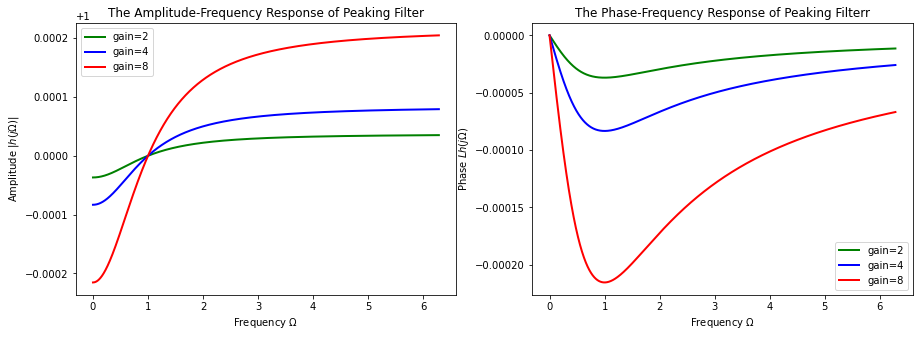

In [42]:
# Your code here 
#
## Visualise the frequency response of Peaking Filter
w = 2*np.pi*np.linspace(0, 1, fs)
Ss2 = peaking_filter(2, 2, 1, fs) 
ws2, hs2 = signal.freqresp(Ss2, w)

Ss4 = peaking_filter(4, 2, 1, fs)   
ws4, hs4 = signal.freqresp(Ss4, w)

Ss8 = peaking_filter(8, 2, 1, fs) 
ws8, hs8 = signal.freqresp(Ss8, w)

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.plot(ws2, abs(hs2),'g', lw=2, label='gain=2')
plt.plot(ws4, abs(hs4),'b', lw=2, label='gain=4')
plt.plot(ws8, abs(hs8),'r', lw=2, label='gain=8')
plt.title('The Amplitude-Frequency Response of Peaking Filter')
plt.ylabel('Amplitude $|h({j \Omega})|$')
plt.xlabel('Frequency $\Omega$')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(ws2, np.angle(hs2),'g', lw=2, label='gain=2')
plt.plot(ws4, np.angle(hs4),'b', lw=2, label='gain=4')
plt.plot(ws8, np.angle(hs8),'r', lw=2, label='gain=8')
plt.title('The Phase-Frequency Response of Peaking Filterr')
plt.ylabel('Phase $Lh({j \Omega})$')
plt.xlabel('Frequency $\Omega$')
plt.legend()
plt.show()


In [43]:
## Visualise the frequency response of low-pass filter
# w = 2*np.pi*np.linspace(0, 1, fs)
# S2 = signal.butter(2, 2, 'low', analog=True, output='ba') 
# w2, h2 = signal.freqresp(S2, w)

# S4 = signal.butter(4, 2, 'low', analog=True, output='ba')  
# w4, h4 = signal.freqresp(S4, w)

# S8 = signal.butter(8, 2, 'low', analog=True, output='ba') 
# w8, h8 = signal.freqresp(S8, w)

# plt.figure(figsize=(15, 5))
# plt.subplot(1, 2, 1)
# plt.plot(w2, abs(h2),'g', lw=2, label='N=2')
# plt.plot(w4, abs(h4),'b', lw=2, label='N=4')
# plt.plot(w8, abs(h8),'r', lw=2, label='N=8')
# plt.title('The Amplitude-Frequency Response of Butterworth Low-pass Filter')
# plt.ylabel('Amplitude $|h({j \Omega})|$')
# plt.xlabel('Frequency $\Omega$')

# plt.subplot(1, 2, 2)
# plt.plot(w2, np.angle(h2),'g', lw=2)
# plt.plot(w4, np.angle(h4),'b', lw=2)
# plt.plot(w8, np.angle(h8),'r', lw=2)
# plt.title('The Phase-Frequency Response of Butterworth Low-pass Filter')
# plt.ylabel('Phase $Lh({j \Omega})$')
# plt.xlabel('Frequency $\Omega$')
# plt.show()

In [44]:
## Define a function to implement a equaliser.
def equaliser(signalin, fs, min_gain, max_gain, min_center_freq, max_center_freq, min_q, max_q):
    '''signalin: 
           input signal to which the effect should be applied; 
       fs: 
           the sample frequency in Hz;
       min_gain:
           the minimized logrithmic gain (in dB)
       max_gain:
           the maximized logrithmic gain (in dB)
       min_center_freq:
           the minimized center frequency
       max_center_freq:
           the maximized center frequency
       min_q:
           the minimized q-term equating to (Fb / Fc)
       max_q:
           the maximized q-term equating to (Fb / Fc)
    '''
    gain = np.linspace(min_gain, max_gain, 20)
    center_freq = np.linspace(min_center_freq, max_center_freq, 20)
    q = np.linspace(min_q, max_q, 20)
    hx = signalin
    fs = fs
    for i in range(20):
        g = gain[i]
        cf = center_freq[i]
        qq = q[i]
        b, a  = peaking_filter(gain=g, center_freq=cf, q=qq, fs=fs)

        hx = signal.filtfilt(b, a, hx)
    return hx



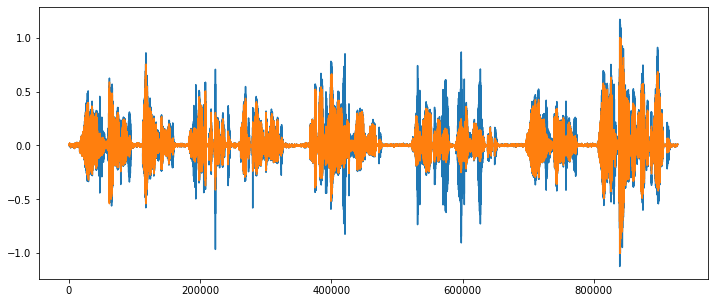

In [45]:
## show an example of the echo effect
h = equaliser(signalin=s, fs=fs, 
              min_gain=1, max_gain=8, min_center_freq=2000, max_center_freq=8000, min_q=10, max_q=50)

# plot frequency response
plt.figure(figsize=(12, 5))

## plot the signal before and after equaliser
plt.plot(h)
plt.plot(s)

# play the output audio
ipd.Audio(h, rate=fs)

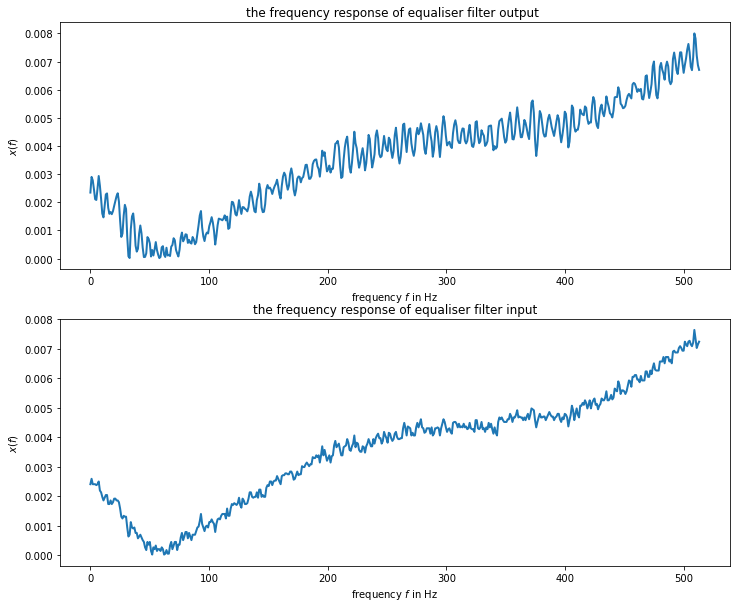

In [46]:
## Visualise the frequency response of equaliser filter and the input and (filtered) output signal.
hf=h[0:513] # only show first half (positive frequencies)
omega=np.linspace(0,len(hf),513)
plt.figure(figsize=(12,10))
plt.subplot(2,1,1)
plt.plot(omega, abs(hf), lw=2)
plt.title('the frequency response of equaliser filter output ')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')

sf=s[0:513] # only show first half (positive frequencies)
omega=np.linspace(0,len(sf),513)
plt.subplot(2,1,2)
plt.plot(omega, abs(sf), lw=2)
plt.title('the frequency response of equaliser filter input')
plt.xlabel('frequency $f$ in Hz');plt.ylabel('$x(f)$')
plt.show()

## 6. Prepare for submission

<br>
<div style="border: 2px solid #999; padding: 10px; background: #abe;">
    
    
**Task T13:**
    
* Create a `.zip` file of the form `YourName.zip` containing this Jupyter Notebook files as well as all other file necessary to run this notebook (**if such exist**, e.g. if you created (additional) WAVE files). 
* Hand-in your `.zip` file via Blackboard.
    

<span style="font-weight:bold;color:red;text-align:center;">**Important: For marking, we expect your code to work ‘out of the box’.**</span>
    
</div>